# Tweets analysis

In [180]:
import pandas as pd
pd.set_option('display.max_rows', 500000)
pd.set_option('display.max_columns', 1000000)
pd.set_option('display.width', 100000)

In [2]:
import GetOldTweets3 as got

# Generating a list of dates in a specific range

In [3]:
from dateutil import rrule, parser

date1 = '2017-12-12'
date2 = '2019-12-12'

dates = list(rrule.rrule(rrule.DAILY,
                         dtstart=parser.parse(date1),
                         until=parser.parse(date2)))
dates

[datetime.datetime(2017, 12, 12, 0, 0),
 datetime.datetime(2017, 12, 13, 0, 0),
 datetime.datetime(2017, 12, 14, 0, 0),
 datetime.datetime(2017, 12, 15, 0, 0),
 datetime.datetime(2017, 12, 16, 0, 0),
 datetime.datetime(2017, 12, 17, 0, 0),
 datetime.datetime(2017, 12, 18, 0, 0),
 datetime.datetime(2017, 12, 19, 0, 0),
 datetime.datetime(2017, 12, 20, 0, 0),
 datetime.datetime(2017, 12, 21, 0, 0),
 datetime.datetime(2017, 12, 22, 0, 0),
 datetime.datetime(2017, 12, 23, 0, 0),
 datetime.datetime(2017, 12, 24, 0, 0),
 datetime.datetime(2017, 12, 25, 0, 0),
 datetime.datetime(2017, 12, 26, 0, 0),
 datetime.datetime(2017, 12, 27, 0, 0),
 datetime.datetime(2017, 12, 28, 0, 0),
 datetime.datetime(2017, 12, 29, 0, 0),
 datetime.datetime(2017, 12, 30, 0, 0),
 datetime.datetime(2017, 12, 31, 0, 0),
 datetime.datetime(2018, 1, 1, 0, 0),
 datetime.datetime(2018, 1, 2, 0, 0),
 datetime.datetime(2018, 1, 3, 0, 0),
 datetime.datetime(2018, 1, 4, 0, 0),
 datetime.datetime(2018, 1, 5, 0, 0),
 datetime.

In [4]:
len(dates)

731

In [5]:
timestampStr = str(dates[0].strftime("%Y-%m-%d"))
timestampStr1 = str(dates[730].strftime("%Y-%m-%d"))
print(timestampStr1)

2019-12-12


# Extracting tweets

In [6]:
tweetCriteria = got.manager.TweetCriteria().setUsername("IBM")\
                                           .setSince("2012-01-01")\
                                           .setUntil("2019-12-12")\              

tweet = got.manager.TweetManager.getTweets(tweetCriteria)

In [7]:
print(len(tweet))

10706


# Creating a tweets dataframe 

In [158]:
columns = ['Tweet']

In [159]:
tweets = pd.DataFrame([t.text for t in tweet], [d.date for d in tweet], columns=columns)
tweets.head()

,Tweet
2019-12-11 18:05:30+00:00,"Hi Martin, we're sorry to hear you're experien..."
2019-12-11 18:00:02+00:00,
2019-12-11 17:48:06+00:00,Way to go Emily!
2019-12-11 17:30:02+00:00,All great sweaters. Happy holidays!
2019-12-11 15:50:02+00:00,#PTECH grad Suriana Rodriguez is hard at work ...


In [160]:
tweets.index.names = ['Date']

In [161]:
tweets.head()

,Tweet
Date,
2019-12-11 18:05:30+00:00,"Hi Martin, we're sorry to hear you're experien..."
2019-12-11 18:00:02+00:00,
2019-12-11 17:48:06+00:00,Way to go Emily!
2019-12-11 17:30:02+00:00,All great sweaters. Happy holidays!
2019-12-11 15:50:02+00:00,#PTECH grad Suriana Rodriguez is hard at work ...


In [162]:
tweets = tweets.reset_index()

In [163]:
# sorting values from older to newer tweets
tweets = tweets.sort_values(by='Date', ascending = True)

In [164]:
tweets = tweets.reset_index(drop=True)

In [165]:
tweets.head()

,Date,Tweet
0,2012-01-01 00:11:47+00:00,Four questions that pushed IBM to stay a step ...
1,2012-01-04 16:00:06+00:00,Today’s Big Blue is ‘Big Open’: http://www.bus...
2,2012-01-05 16:15:03+00:00,Good Co. Project via IBM Facebook Mid-Market p...
3,2012-01-05 18:38:22+00:00,IBM to buy Green Hat:
4,2012-01-06 14:41:21+00:00,IBM 2011 accessibility articles compiled: http...


In [166]:
tweets.to_csv('tweets.csv',index=False)

# Formatting date column

In [167]:
tweets.Date = tweets.Date.dt.strftime('%d-%b-%Y')

In [168]:
tweets['Date']=pd.to_datetime(tweets['Date'])

# Grouping tweets per day

In [174]:
tweets

,Date,Tweet
0,2012-01-01,Four questions that pushed IBM to stay a step ...
1,2012-01-04,Today’s Big Blue is ‘Big Open’: http://www.bus...
2,2012-01-05,Good Co. Project via IBM Facebook Mid-Market p...
3,2012-01-05,IBM to buy Green Hat:
4,2012-01-06,IBM 2011 accessibility articles compiled: http...
5,2012-01-09,IBM social media animation from the past few y...
6,2012-01-11,IBM breaks U.S. patent record: http://www-03.i...
7,2012-01-11,IBM Grabs Top Patent Crown Again http://www.ew...
8,2012-01-12,"Pushing the boundaries of nanotechnology, via ..."
9,2012-01-16,When Luis Suarez decided to live in a world wi...


In [170]:
#tweets_day = tweets.groupby(pd.Grouper(key='Date', freq = 'D')).join(tweets['Tweet'])

In [172]:
tweets_day = tweets.groupby('Date')['Tweet'].agg(' '.join)

In [176]:
tweets_day = tweets_day.to_frame()

In [190]:
tweets_day = tweets_day.reset_index()

# Tweets cleaning

In [185]:
import nltk
from nltk.tokenize import word_tokenize
from nltk.stem import PorterStemmer 
from nltk.stem.snowball import SnowballStemmer
from nltk.stem import WordNetLemmatizer 
from nltk.corpus import stopwords
import re

In [191]:
def clean_up(s):
    w = re.sub(r'http\S+', ' ', s).replace("'", " ").lower()
    w = re.sub(r"[^a-zA-Z]", " ", w)
    return w

def tokenize(s):
    w = nltk.word_tokenize(s)
    return w   

def stem_and_lemmatize(l):
    ps = PorterStemmer()
    lemmatizer = WordNetLemmatizer()
    a = [lemmatizer.lemmatize(ps.stem(w)) for w in l]
    return a

def remove_stopwords(s):
    stop_words = stopwords.words('english')
    w = [x for x in s if x not in stop_words]
    return w

In [192]:
tweets_day['Tweet_processed'] = tweets_day.apply(lambda x : remove_stopwords(
    stem_and_lemmatize(tokenize(clean_up(x['Tweet'])))), axis = 1)

In [193]:
tweets_day

,Date,Tweet,Tweet_processed
0,2012-01-01,Four questions that pushed IBM to stay a step ahead of its rivals: http://www.nytimes.com/2012/01/01/business/how-samuel-palmisano-of-ibm-stayed-a-step-ahead-unboxed.html?_r=1&amp;pagewanted=all,"[four, question, push, ibm, stay, step, ahead, rival]"
1,2012-01-04,Today’s Big Blue is ‘Big Open’: http://www.businessinsider.com/why-every-company-needs-to-be-more-like-ibm-and-less-like-apple-2012-1,"[today, big, blue, big, open]"
2,2012-01-05,Good Co. Project via IBM Facebook Mid-Market page: https://www.facebook.com/MidmarketIBM?sk=app_228046053890511 IBM to buy Green Hat:,"[good, co, project, via, ibm, facebook, mid, market, page, ibm, buy, green, hat]"
3,2012-01-06,IBM 2011 accessibility articles compiled: http://bit.ly/y8CXR9,"[ibm, access, articl, compil]"
4,2012-01-09,"IBM social media animation from the past few years, YouTube playlist:","[ibm, social, medium, anim, past, year, youtub, playlist]"
5,2012-01-11,IBM breaks U.S. patent record: http://www-03.ibm.com/press/us/en/pressrelease/36463.wss IBM Grabs Top Patent Crown Again http://www.eweek.com/c/a/IT-Management/IBM-Grabs-Top-Patent-Crown-Again-387637/ via eWeek,"[ibm, break, u, patent, record, ibm, grab, top, patent, crown, via, eweek]"
6,2012-01-12,"Pushing the boundaries of nanotechnology, via NYT's: http://www.nytimes.com/2012/01/13/science/smaller-magnetic-materials-push-boundaries-of-nanotechnology.html?_r=1","[push, boundari, nanotechnolog, via, nyt]"
7,2012-01-16,"When Luis Suarez decided to live in a world without e-mail, some of his colleagues thought he was making a mistake http://www.wired.com/wiredenterprise/2012/01/luis-suarez/ IBM closing in on the one-charge 500 mile electric vehicle: http://bit.ly/wPxROv","[lui, suarez, decid, live, world, without, e, mail, hi, colleagu, thought, wa, make, mistak, ibm, close, one, charg, mile, electr, vehicl]"
8,2012-01-18,"How Sam Palmisano Redefined the Global Corporation: http://blogs.hbr.org/hbsfaculty/2012/01/how-ibms-sam-palmisano-redefin.html #HBR 10 Ways to Transform Into a Social Enterprise: http://www.informationweek.com/thebrainyard/news/social_networking_consumer/232500057#.Txcthsr0Vts.facebook IBM's Sam Palmisano, ""I just want to leave the company better than I found it""","[sam, palmisano, redefin, global, corpor, hbr, way, transform, social, enterpris, ibm, sam, palmisano, want, leav, compani, better, found]"
9,2012-01-19,"Strong 4Q 2011 performance by IBM caps year of record earnings per share, revenue, profit and free cash flow http://ibm.co/xA8XkP Stories of a Smarter Planet: http://www.ibm.com/smarterplanet/global/share/19jan2012/ Is mobile Africa's future? http://www.ibm.com/smarterplanet/global/share/19jan2012/mobile_africa/ What makes you sick? http://www.ibm.com/smarterplanet/global/share/19jan2012/watson_healthcare/ Do you really know your food? http://www.ibm.com/smarterplanet/global/share/19jan2012/food_tracking/","[strong, q, perform, ibm, cap, year, record, earn, per, share, revenu, profit, free, cash, flow, stori, smarter, planet, mobil, africa, futur, make, sick, realli, know, food]"


In [196]:
tweets_day.to_csv('tweets.csv',index=False)

In [194]:
from nltk.probability import FreqDist
words = [w for l in tweets_day['Tweet_processed'] for w in l]
fdist = FreqDist(words)
fdist

FreqDist({'ibm': 3176, 'thank': 1174, 'ibmwatson': 952, 'via': 808, 'help': 736, 'new': 695, 'rt': 687, 'thi': 671, 'hi': 554, 'learn': 550, ...})

# Wordcloud 

In [203]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

In [200]:
wordcloud2 = WordCloud().generate(' '.join(tweets_day['Tweet']))

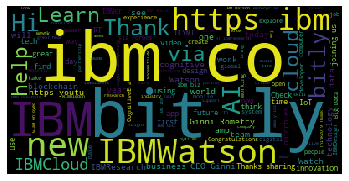

In [205]:
plt.imshow(wordcloud2)
plt.axis("off")
plt.savefig('word_could.jpg', bbox_inches = 'tight', transparent = True)

plt.show()

In [184]:
tweets_day.to_csv('tweets.csv',index=False)